<a href="https://colab.research.google.com/github/rmvjh27/hackbio-stage3/blob/main/Single_Cell_Analysis_With_Trajectory.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# scRNA-seq Data Analysis with Trajectory Inference

## 0. Install the required libraries

In [1]:
!pip install scanpy
!pip install anndata
!pip install igraph
!pip install decoupler
!pip install fa2-modified

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 27.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 172.3/172.3 kB 11.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.2/58.2 kB 5.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 284.1/284.1 kB 20.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 9.2/9.2 MB 40.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.7/5.7 MB 59.8 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.0/62.0 kB 5.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 120.9/120.9 kB 10.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 37.3/37.3 MB 22.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 85.0/85.0 kB 8.2 MB/s eta 0:00:00
  Created wheel for docrep: filename=docrep-0.3.2-py3-none-any.whl size=19876 sha256=a82617da51891388070688c513011b90b039eb640ced26d776d0331571713567
  Stored in director

In [2]:
# Import core tools
import scanpy as sc
import anndata as ad
import numpy as np

## 1. Import the data

In [3]:
# make a new directory
!mkdir -p GSE166766

# download the dataset
!wget https://ftp.ncbi.nlm.nih.gov/geo/series/GSE166nnn/GSE166766/suppl/GSE166766_RAW.tar -O /content/GSE166766/GSE166766_RAW.tar

# extract the .tar file
!tar -xvf /content/GSE166766/GSE166766_RAW.tar -C /content/GSE166766

--2025-12-04 02:14:07--  https://ftp.ncbi.nlm.nih.gov/geo/series/GSE166nnn/GSE166766/suppl/GSE166766_RAW.tar
Resolving ftp.ncbi.nlm.nih.gov (ftp.ncbi.nlm.nih.gov)... 130.14.250.7, 130.14.250.10, 130.14.250.11, ...
Connecting to ftp.ncbi.nlm.nih.gov (ftp.ncbi.nlm.nih.gov)|130.14.250.7|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 838123520 (799M) [application/x-tar]
Saving to: ‘/content/GSE166766/GSE166766_RAW.tar’

/content/GSE166766/ 100%[===================>] 799.30M  42.7MB/s    in 19s     

2025-12-04 02:14:26 (42.7 MB/s) - ‘/content/GSE166766/GSE166766_RAW.tar’ saved [838123520/838123520]

GSM5082289_mock_barcodes.tsv.gz
GSM5082289_mock_features.tsv.gz
GSM5082289_mock_matrix.mtx.gz
GSM5082290_1dpi_barcodes.tsv.gz
GSM5082290_1dpi_features.tsv.gz
GSM5082290_1dpi_matrix.mtx.gz
GSM5082291_2dpi_barcodes.tsv.gz
GSM5082291_2dpi_features.tsv.gz
GSM5082291_2dpi_matrix.mtx.gz
GSM5082292_3dpi_barcodes.tsv.gz
GSM5082292_3dpi_features.tsv.gz
GSM5082292_3dpi_matrix.m

In [4]:
# make new working directory
import shutil
!mkdir working_dir
!mkdir /content/working_dir/mock /content/working_dir/1dpi /content/working_dir/2dpi /content/working_dir/3dpi

groups = ['mock', '1dpi', '2dpi', '3dpi']
filenames = ['GSM5082289_mock', 'GSM5082290_1dpi',
             'GSM5082291_2dpi', 'GSM5082292_3dpi']

# copy barcodes, features, and matrix files from the GSE151309 folder to corresponding folders
for i in range(len(groups)):
    shutil.copy(f'/content/GSE166766/{filenames[i]}_barcodes.tsv.gz', f'/content/working_dir/{groups[i]}/barcodes.tsv.gz')
    shutil.copy(f'/content/GSE166766/{filenames[i]}_features.tsv.gz', f'/content/working_dir/{groups[i]}/features.tsv.gz')
    shutil.copy(f'/content/GSE166766/{filenames[i]}_matrix.mtx.gz', f'/content/working_dir/{groups[i]}/matrix.mtx.gz')

# delete old files
!rm -rf /content/GSE166766

In [5]:
# load the data into AnnData objects
mock_adata = sc.read_10x_mtx('/content/working_dir/mock/')
dpi1_adata = sc.read_10x_mtx('/content/working_dir/1dpi/')
dpi2_adata = sc.read_10x_mtx('/content/working_dir/2dpi/')
dpi3_adata = sc.read_10x_mtx('/content/working_dir/3dpi/')

# keep only unique gene names
mock_adata.var_names_make_unique()
dpi1_adata.var_names_make_unique()
dpi2_adata.var_names_make_unique()
dpi3_adata.var_names_make_unique()

## 2. Quality Control and Normalization

In [6]:
# check whether each AnnData object has the same number of observations and variables
print(mock_adata)
print(dpi1_adata)
print(dpi2_adata)
print(dpi3_adata)

AnnData object with n_obs × n_vars = 22609 × 33539
    var: 'gene_ids', 'feature_types'
AnnData object with n_obs × n_vars = 11834 × 33539
    var: 'gene_ids', 'feature_types'
AnnData object with n_obs × n_vars = 14695 × 33539
    var: 'gene_ids', 'feature_types'
AnnData object with n_obs × n_vars = 28530 × 33539
    var: 'gene_ids', 'feature_types'


In [7]:
# add column that indicates condition/treatment group
mock_adata.obs['condition'] = 'mock'
dpi1_adata.obs['condition'] = '1dpi'
dpi2_adata.obs['condition'] = '2dpi'
dpi3_adata.obs['condition'] = '3dpi'

In [8]:
# remove genes expressed in less than 3 cells
sc.pp.filter_genes(mock_adata, min_cells=3)
sc.pp.filter_genes(dpi1_adata, min_cells=3)
sc.pp.filter_genes(dpi2_adata, min_cells=3)
sc.pp.filter_genes(dpi3_adata, min_cells=3)

In [9]:
# remove cells with less than 200 genes in each group
sc.pp.filter_cells(mock_adata, min_genes=200)
sc.pp.filter_cells(dpi1_adata, min_genes=200)
sc.pp.filter_cells(dpi2_adata, min_genes=200)
sc.pp.filter_cells(dpi3_adata, min_genes=200)

In [10]:
# check dimensions after filtering
print(mock_adata.shape)
print(dpi1_adata.shape)
print(dpi2_adata.shape)
print(dpi3_adata.shape)

(22608, 21691)
(11829, 21983)
(14690, 22170)
(28523, 22251)


In [11]:
# index for mitochondrial reads
mock_adata.var['MT'] = mock_adata.var_names.str.startswith('MT-')
dpi1_adata.var['MT'] = dpi1_adata.var_names.str.startswith('MT-')
dpi2_adata.var['MT'] = dpi2_adata.var_names.str.startswith('MT-')
dpi3_adata.var['MT'] = dpi3_adata.var_names.str.startswith('MT-')

# index for ribosomal transcripts
mock_adata.var['ribo'] = mock_adata.var_names.str.startswith(("RPS","RPL"))
dpi1_adata.var['ribo'] = dpi1_adata.var_names.str.startswith(("RPS","RPL"))
dpi2_adata.var['ribo'] = dpi2_adata.var_names.str.startswith(("RPS","RPL"))
dpi3_adata.var['ribo'] = dpi3_adata.var_names.str.startswith(("RPS","RPL"))

# index for hemoglobin genes
mock_adata.var['HB'] = mock_adata.var_names.str.startswith("^HB[^(P)]")
dpi1_adata.var['HB'] = dpi1_adata.var_names.str.startswith("^HB[^(P)]")
dpi2_adata.var['HB'] = dpi2_adata.var_names.str.startswith("^HB[^(P)]")
dpi3_adata.var['HB'] = dpi3_adata.var_names.str.startswith("^HB[^(P)]")

In [12]:
# which genes are mitochondrial?
mock_adata.var['MT'].loc[mock_adata.var['MT'] == True]

,MT
MT-ND1,True
MT-ND2,True
MT-CO1,True
MT-CO2,True
MT-ATP8,True
MT-ATP6,True
MT-CO3,True
MT-ND3,True
MT-ND4L,True
MT-ND4,True


In [13]:
# which genes are ribosomal?
mock_adata.var['ribo'].loc[mock_adata.var['ribo'] == True]

,ribo
RPL22,True
RPL11,True
RPS6KA1,True
RPS8,True
RPL5,True
...,...
RPL28,True
RPS5,True
RPS4Y1,True
RPL3,True


In [14]:
# hemoglobin genes
mock_adata.var['HB'].loc[mock_adata.var['HB'] == True]

,HB


In [15]:
# calculate QC metrics
sc.pp.calculate_qc_metrics(mock_adata, qc_vars=['MT', 'ribo', 'HB'], inplace=True)

In [16]:
sc.pp.calculate_qc_metrics(dpi1_adata, qc_vars=['MT', 'ribo', 'HB'], inplace=True)

In [17]:
sc.pp.calculate_qc_metrics(dpi2_adata, qc_vars=['MT', 'ribo', 'HB'], inplace=True)

In [18]:
sc.pp.calculate_qc_metrics(dpi3_adata, qc_vars=['MT', 'ribo', 'HB'], inplace=True)

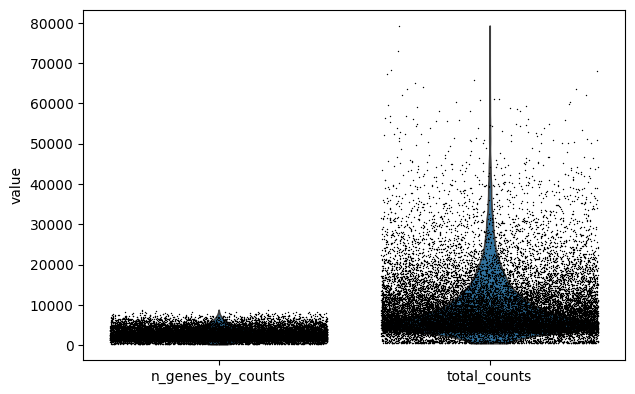

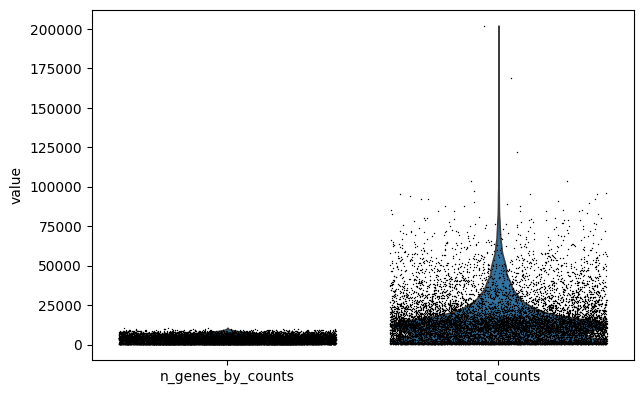

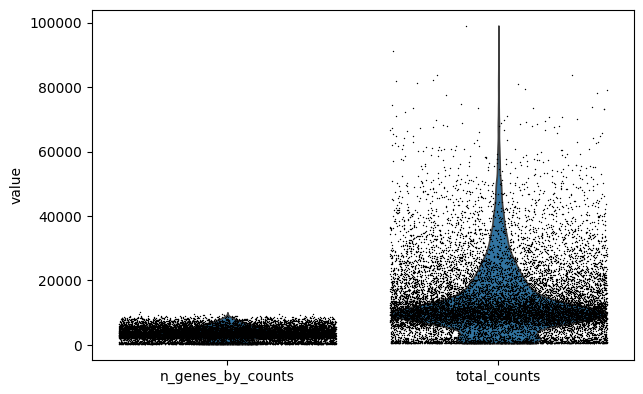

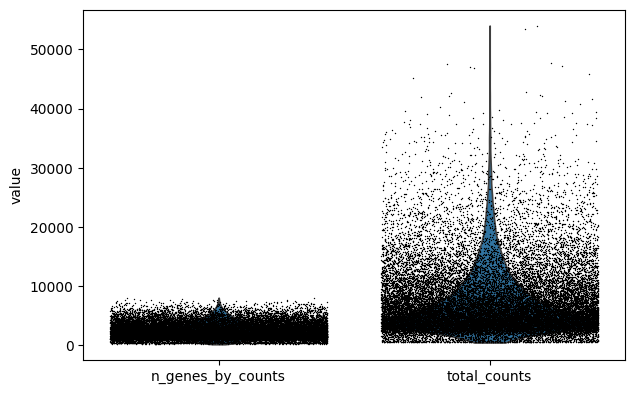

In [19]:
# visualize number of genes by counts and total counts
sc.pl.violin(mock_adata,
             ["n_genes_by_counts", "total_counts"],
             jitter=0.4)

sc.pl.violin(dpi1_adata,
             ["n_genes_by_counts", "total_counts"],
             jitter=0.4)

sc.pl.violin(dpi2_adata,
             ["n_genes_by_counts", "total_counts"],
             jitter=0.4)

sc.pl.violin(dpi3_adata,
             ["n_genes_by_counts", "total_counts"],
             jitter=0.4)

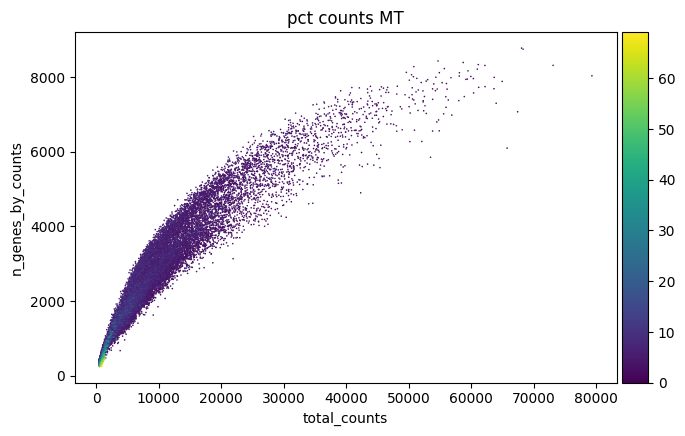

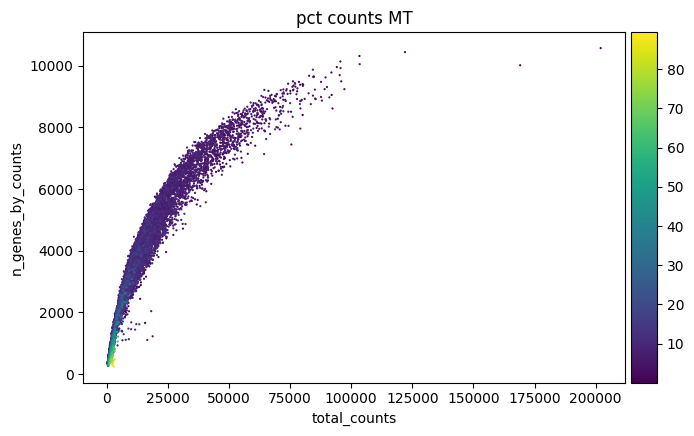

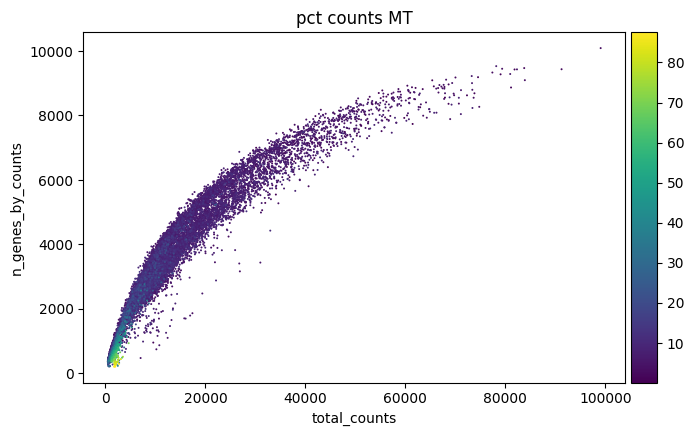

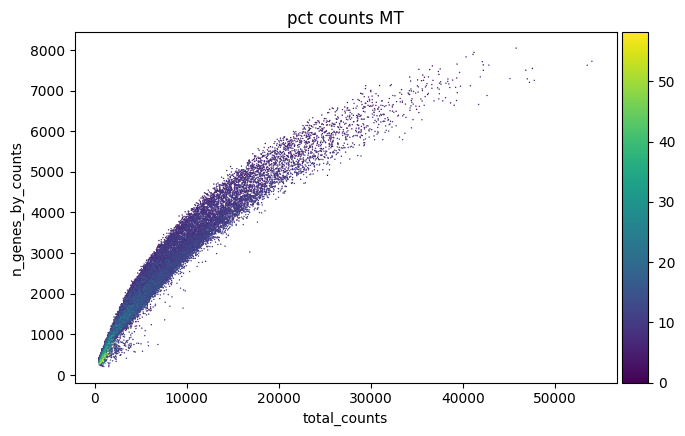

In [20]:
# visualize cells based on mitochondrial reads
sc.pl.scatter(mock_adata, "total_counts", "n_genes_by_counts", color="pct_counts_MT")
sc.pl.scatter(dpi1_adata, "total_counts", "n_genes_by_counts", color="pct_counts_MT")
sc.pl.scatter(dpi2_adata, "total_counts", "n_genes_by_counts", color="pct_counts_MT")
sc.pl.scatter(dpi3_adata, "total_counts", "n_genes_by_counts", color="pct_counts_MT")

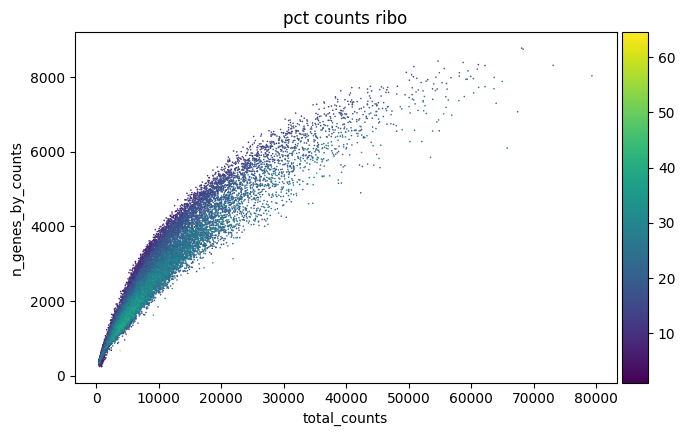

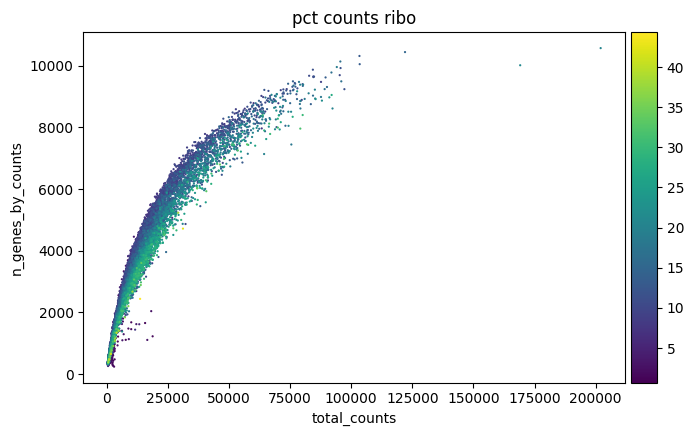

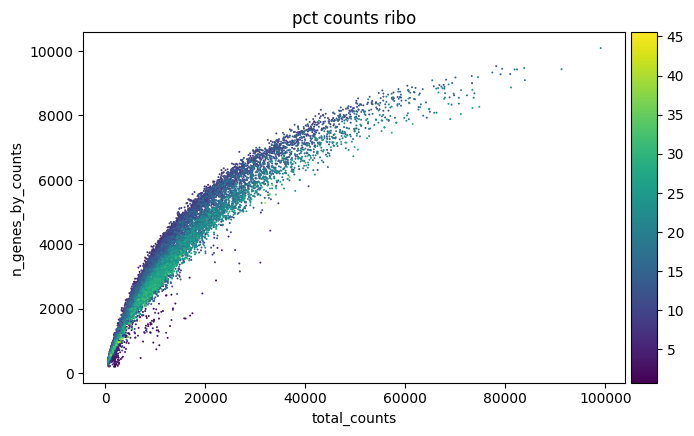

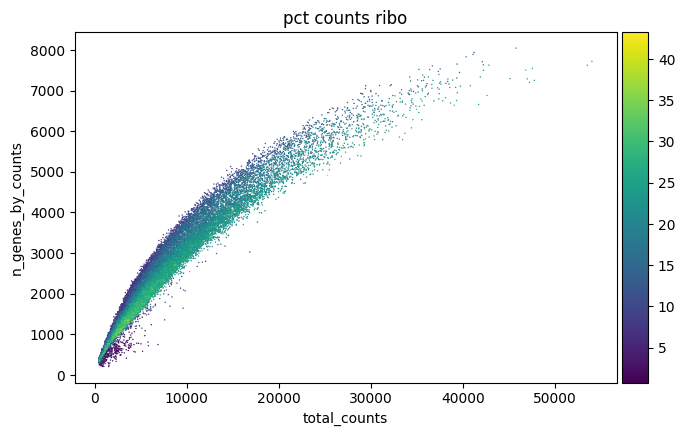

In [21]:
# visualize cells based on ribosomal reads
sc.pl.scatter(mock_adata, "total_counts", "n_genes_by_counts", color="pct_counts_ribo")
sc.pl.scatter(dpi1_adata, "total_counts", "n_genes_by_counts", color="pct_counts_ribo")
sc.pl.scatter(dpi2_adata, "total_counts", "n_genes_by_counts", color="pct_counts_ribo")
sc.pl.scatter(dpi3_adata, "total_counts", "n_genes_by_counts", color="pct_counts_ribo")

In [22]:
# remove cells with mitochondrial genes above 10%
mock_adata = mock_adata[mock_adata.obs['pct_counts_MT'] < 10, :]
dpi1_adata = dpi1_adata[dpi1_adata.obs['pct_counts_MT'] < 10, :]
dpi2_adata = dpi2_adata[dpi2_adata.obs['pct_counts_MT'] < 10, :]
dpi3_adata = dpi3_adata[dpi3_adata.obs['pct_counts_MT'] < 10, :]

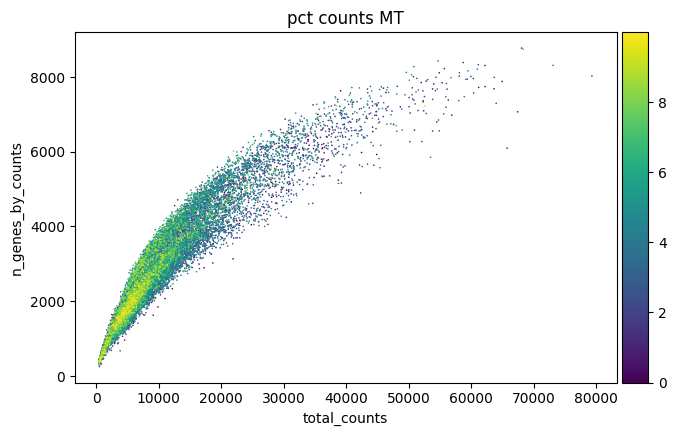

In [23]:
# display n_genes_by_counts vs total_counts after filtering
sc.pl.scatter(mock_adata, "total_counts", "n_genes_by_counts", color="pct_counts_MT")

In [24]:
# Save a copy of the raw counts as a new layer
mock_adata.layers["counts"] = mock_adata.X.copy()
dpi1_adata.layers["counts"] = dpi1_adata.X.copy()
dpi2_adata.layers["counts"] = dpi2_adata.X.copy()
dpi3_adata.layers["counts"] = dpi3_adata.X.copy()

/tmp/ipython-input-1291024713.py:2: ImplicitModificationWarning: Setting element `.layers['counts']` of view, initializing view as actual.
  mock_adata.layers["counts"] = mock_adata.X.copy()
/tmp/ipython-input-1291024713.py:3: ImplicitModificationWarning: Setting element `.layers['counts']` of view, initializing view as actual.
  dpi1_adata.layers["counts"] = dpi1_adata.X.copy()
/tmp/ipython-input-1291024713.py:4: ImplicitModificationWarning: Setting element `.layers['counts']` of view, initializing view as actual.
  dpi2_adata.layers["counts"] = dpi2_adata.X.copy()
/tmp/ipython-input-1291024713.py:5: ImplicitModificationWarning: Setting element `.layers['counts']` of view, initializing view as actual.
  dpi3_adata.layers["counts"] = dpi3_adata.X.copy()


In [25]:
# Normalize the data towards the median
sc.pp.normalize_total(mock_adata)
sc.pp.normalize_total(dpi1_adata)

In [26]:
sc.pp.normalize_total(dpi2_adata)
sc.pp.normalize_total(dpi3_adata)

In [27]:
# log transformation
sc.pp.log1p(mock_adata)
sc.pp.log1p(dpi1_adata)
sc.pp.log1p(dpi2_adata)
sc.pp.log1p(dpi3_adata)

In [28]:
# Feature selection (select top 1000 most variable genes)
sc.pp.highly_variable_genes(mock_adata, n_top_genes=1000)
sc.pp.highly_variable_genes(dpi1_adata, n_top_genes=1000)

In [29]:
sc.pp.highly_variable_genes(dpi2_adata, n_top_genes=1000)
sc.pp.highly_variable_genes(dpi3_adata, n_top_genes=1000)

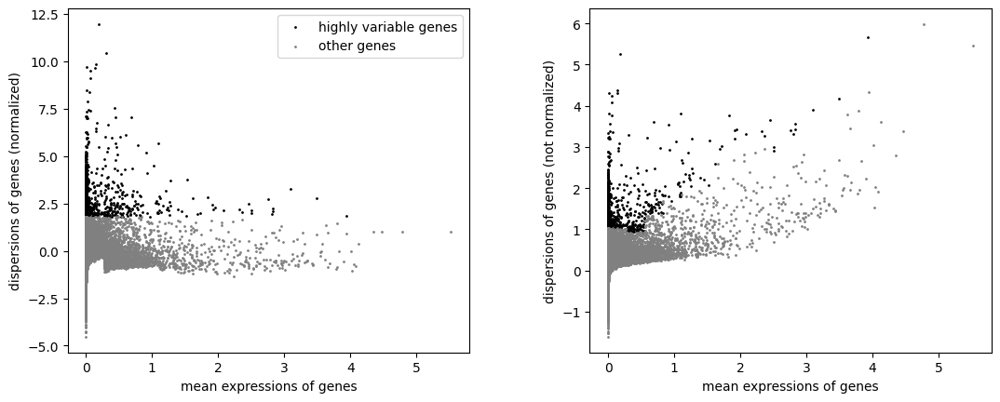

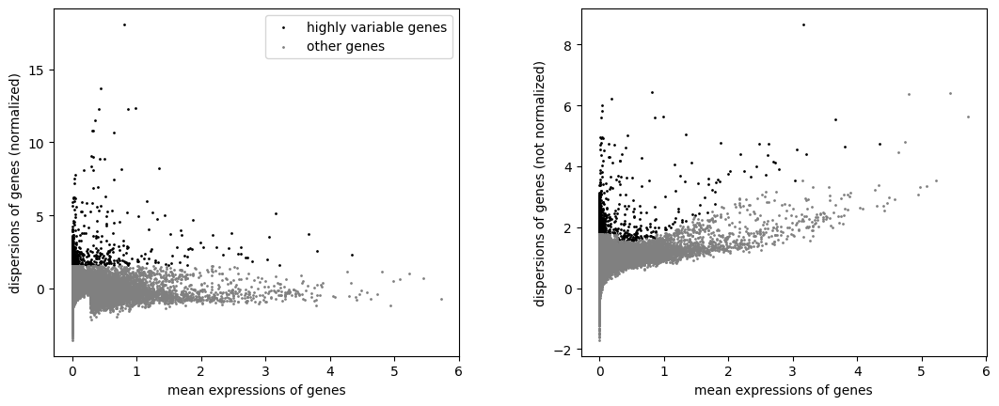

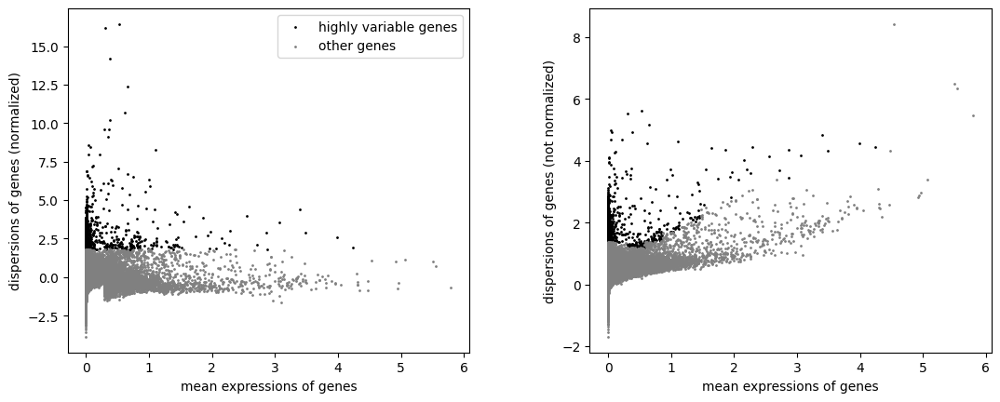

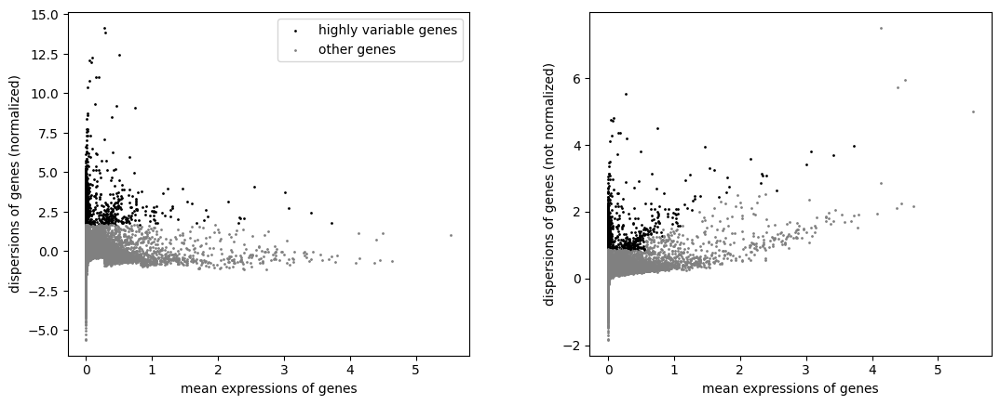

In [30]:
# plot the distribution of genes after and before normalization
sc.pl.highly_variable_genes(mock_adata)
sc.pl.highly_variable_genes(dpi1_adata)
sc.pl.highly_variable_genes(dpi2_adata)
sc.pl.highly_variable_genes(dpi3_adata)

## 3. Dimensionality Reduction and Clustering

In [31]:
# perform principal component analysis
sc.tl.pca(mock_adata)

In [32]:
sc.tl.pca(dpi1_adata)

In [33]:
sc.tl.pca(dpi2_adata)

In [34]:
sc.tl.pca(dpi3_adata)

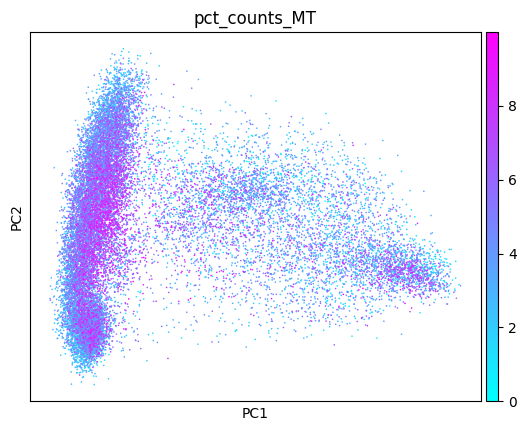

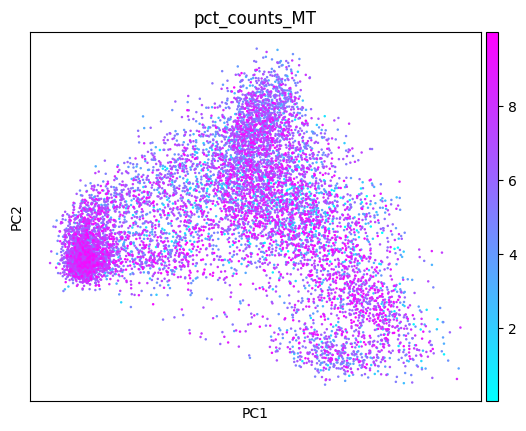

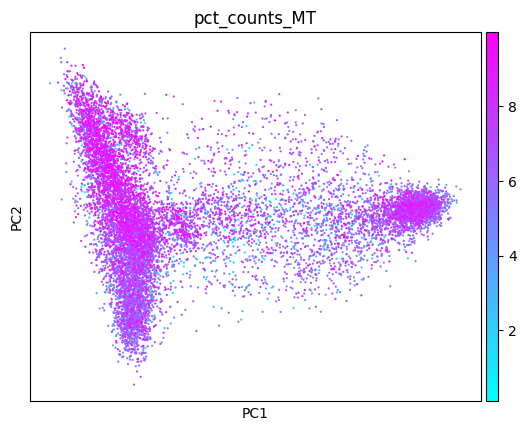

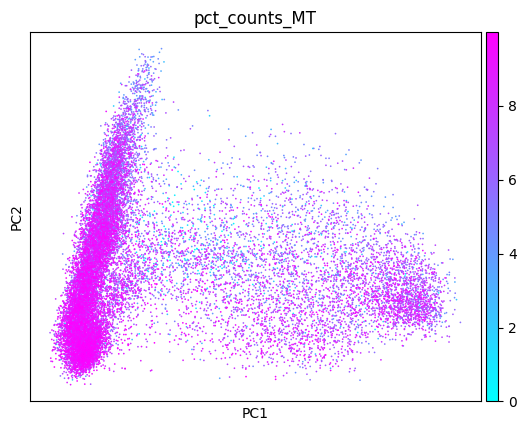

In [35]:
# display clustering of cells based on principal components
sc.pl.pca(mock_adata, color = 'pct_counts_MT', cmap='cool')
sc.pl.pca(dpi1_adata, color = 'pct_counts_MT', cmap='cool')
sc.pl.pca(dpi2_adata, color = 'pct_counts_MT', cmap='cool')
sc.pl.pca(dpi3_adata, color = 'pct_counts_MT', cmap='cool')

In [36]:
# compute nearest neighbors and perform UMAP clustering
sc.pp.neighbors(mock_adata)
sc.tl.umap(mock_adata)

In [37]:
sc.pp.neighbors(dpi1_adata)
sc.tl.umap(dpi1_adata)

In [38]:
sc.pp.neighbors(dpi2_adata)
sc.tl.umap(dpi2_adata)

In [39]:
sc.pp.neighbors(dpi3_adata)
sc.tl.umap(dpi3_adata)

In [77]:
# Leiden clustering
sc.tl.leiden(mock_adata, flavor='igraph', n_iterations=2, resolution=0.15)
sc.tl.leiden(dpi1_adata, flavor='igraph', n_iterations=2, resolution=0.15)
sc.tl.leiden(dpi2_adata, flavor='igraph', n_iterations=2, resolution=0.15)
sc.tl.leiden(dpi3_adata, flavor='igraph', n_iterations=2, resolution=0.15)

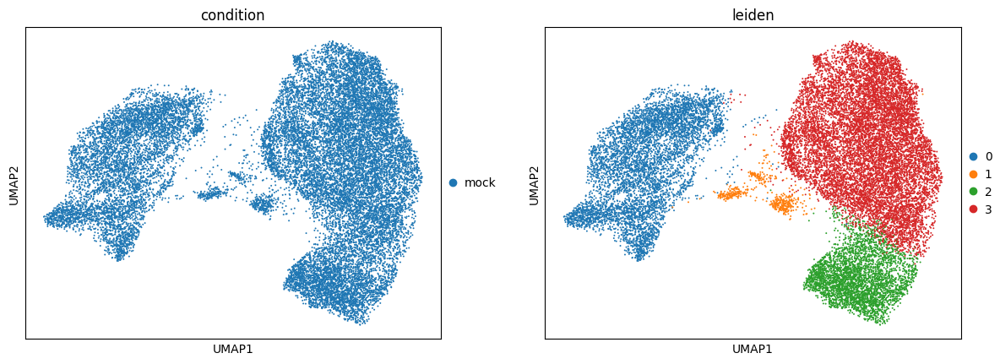

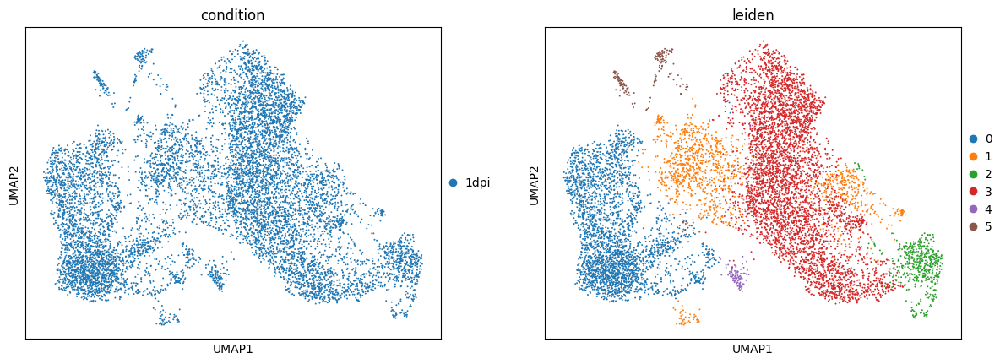

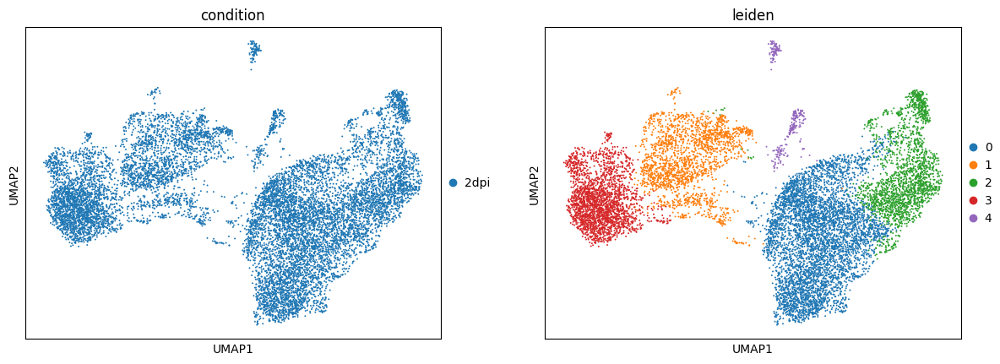

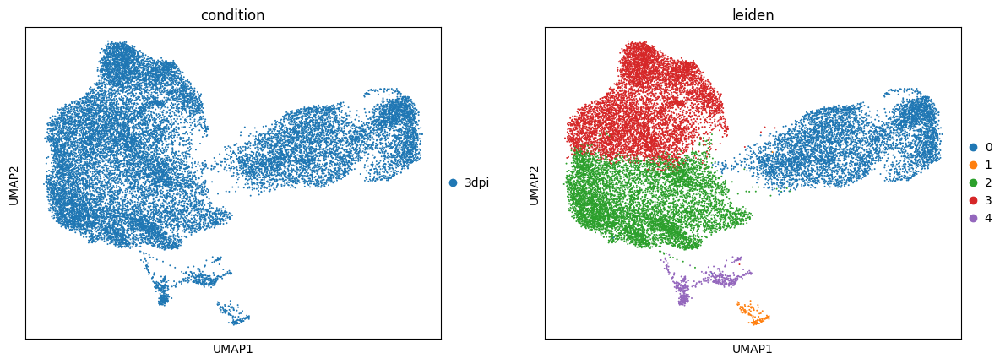

In [78]:
sc.pl.umap(mock_adata, color=['condition','leiden'], size=8)
sc.pl.umap(dpi1_adata, color=['condition','leiden'], size=8)
sc.pl.umap(dpi2_adata, color=['condition','leiden'], size=8)
sc.pl.umap(dpi3_adata, color=['condition','leiden'], size=8)

## 4. Cell Type Annotation

In [48]:
# import the decoupler library
import decoupler as dc

# query Omnipath and fetch PanglaoDB as repository of marker genes
markers = dc.op.resource(name='PanglaoDB', organism='human', license='academic', verbose=True)

Progress: 6.01MB [00:00, 19.0MB/s]


In [49]:
# preview list of markers
markers.head()

,genesymbol,canonical_marker,cell_type,germ_layer,human,human_sensitivity,human_specificity,mouse,mouse_sensitivity,mouse_specificity,ncbi_tax_id,organ,ubiquitiousness
,,,,,,,,,,,,,
0,A1CF,False,Hepatocytes,Endoderm,True,0.189189,0.004437,True,0.175000,0.000257,9606,Liver,0.002
1,A2APA5,False,Germ cells,Mesoderm,False,0.000000,0.000000,True,0.432927,0.000000,10090,Reproductive,0.004
2,A2M,True,Bergmann glia,Ectoderm,True,0.000000,0.062343,True,0.333333,0.001604,9606,Brain,0.012
3,A3FIN4,False,Mast cells,Mesoderm,False,0.000000,0.000000,True,0.184211,0.000708,10090,Immune system,0.001
4,A4GALT,True,Mast cells,Mesoderm,True,0.000000,0.014133,True,0.000000,0.003023,9606,Immune system,0.005


In [50]:
# display all possible organs
markers['organ'].unique()

array(['Liver', 'Reproductive', 'Brain', 'Immune system', 'Zygote',
       'Kidney', 'Blood', 'Lungs', 'Bone', 'GI tract', nan, 'Vasculature',
       'Pancreas', 'Heart', 'Mammary gland', 'Olfactory system',
       'Connective tissue', 'Epithelium', 'Skeletal muscle', 'Skin',
       'Embryo', 'Smooth muscle', 'Eye', 'Adrenal glands', 'Thyroid',
       'Placenta', 'Thymus', 'Parathyroid glands', 'Oral cavity',
       'Urinary bladder'], dtype=object)

In [51]:
# keep only markers that are specific to lungs
markers = markers[markers['organ'] == 'Lungs']

In [52]:
# display markers that are going to be used
markers.head()

,genesymbol,canonical_marker,cell_type,germ_layer,human,human_sensitivity,human_specificity,mouse,mouse_sensitivity,mouse_specificity,ncbi_tax_id,organ,ubiquitiousness
,,,,,,,,,,,,,
18,ABCA3,True,Pulmonary alveolar type II cells,Endoderm,True,0.692308,0.000944,True,0.007576,0.000518,9606,Lungs,0.001
31,ABCD3,True,Pulmonary alveolar type II cells,Endoderm,True,0.000000,0.009437,True,0.340909,0.046722,9606,Lungs,0.041
172,ADGRF5,True,Pulmonary alveolar type II cells,Endoderm,True,0.538462,0.015728,True,0.590909,0.050023,9606,Lungs,0.047
186,ADH7,True,Airway epithelial cells,Endoderm,True,0.000000,0.004386,True,0.000000,0.006288,9606,Lungs,0.006
222,AGER,True,Pulmonary alveolar type I cells,Endoderm,True,0.000000,0.001253,True,1.000000,0.011382,9606,Lungs,0.011


In [53]:
# keep only the canonical cell markers
markers = markers[markers['canonical_marker']]

# remove duplicate entries
markers = markers[~markers.duplicated(['cell_type', 'genesymbol'])]

# change the column names to 'source' and 'target'
markers = markers.rename(columns={'cell_type':'source', 'genesymbol':'target'})
markers = markers[['source', 'target']]

In [54]:
# preview the list of marker genes
markers.head()

,source,target
,,
18,Pulmonary alveolar type II cells,ABCA3
31,Pulmonary alveolar type II cells,ABCD3
172,Pulmonary alveolar type II cells,ADGRF5
186,Airway epithelial cells,ADH7
222,Pulmonary alveolar type I cells,AGER


In [79]:
# perform ULM scoring on gene expression data
dc.mt.ulm(data=mock_adata, net=markers, tmin=3, bsize=5000)

In [80]:
dc.mt.ulm(data=dpi1_adata, net=markers, tmin=3, bsize=5000)

In [81]:
dc.mt.ulm(data=dpi2_adata, net=markers, tmin=3, bsize=5000)

In [82]:
dc.mt.ulm(data=dpi3_adata, net=markers, tmin=3, bsize=5000)

In [83]:
# retrieve the scoring results and store it in the .obsm of each object
mock_score = dc.pp.get_obsm(mock_adata, key='score_ulm')
mock_score

AnnData object with n_obs × n_vars = 21825 × 8
    obs: 'condition', 'n_genes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_MT', 'log1p_total_counts_MT', 'pct_counts_MT', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_HB', 'log1p_total_counts_HB', 'pct_counts_HB', 'leiden'
    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'leiden', 'condition_colors', 'leiden_colors'
    obsm: 'X_pca', 'X_umap', 'score_ulm', 'padj_ulm'

In [84]:
dpi1_score = dc.pp.get_obsm(dpi1_adata, key='score_ulm')
dpi2_score = dc.pp.get_obsm(dpi2_adata, key='score_ulm')
dpi3_score = dc.pp.get_obsm(dpi3_adata, key='score_ulm')

In [85]:
# show list of cell types
mock_adata.obsm['score_ulm'].columns

Index(['Airway epithelial cells', 'Airway goblet cells',
       'Alveolar macrophages', 'Ciliated cells', 'Clara cells', 'Ionocytes',
       'Pulmonary alveolar type I cells', 'Pulmonary alveolar type II cells'],
      dtype='object')

In [86]:
# preview the scoring data for each cell
mock_adata.obsm['score_ulm'].head()

,Airway epithelial cells,Airway goblet cells,Alveolar macrophages,Ciliated cells,Clara cells,Ionocytes,Pulmonary alveolar type I cells,Pulmonary alveolar type II cells
AAACCCACAAGCCATT-1,0.197889,4.373820,0.197889,1.016067,5.571661,-0.949939,0.928951,1.435508
AAACCCACAGACACAG-1,0.922793,-0.198580,1.976168,0.833800,0.803403,-0.837334,3.403305,1.375807
AAACCCACAGAGGAAA-1,1.430704,3.071839,2.051541,-0.484157,5.272171,-0.069718,1.759942,-0.193027
AAACCCACAGGACAGT-1,1.062564,0.702658,-0.428219,1.350553,1.068888,-0.605651,-0.470820,-0.436047
AAACCCACAGTTCTAG-1,-0.467742,6.296366,-0.467742,-0.405067,5.580231,0.288934,1.882888,0.119431


In [87]:
# rank marker genes based on scoring results
mock_adata_rank = dc.tl.rankby_group(mock_score, groupby='leiden', reference='rest', method='t-test_overestim_var')
dpi1_adata_rank = dc.tl.rankby_group(dpi1_score, groupby='leiden', reference='rest', method='t-test_overestim_var')
dpi2_adata_rank = dc.tl.rankby_group(dpi2_score, groupby='leiden', reference='rest', method='t-test_overestim_var')
dpi3_adata_rank = dc.tl.rankby_group(dpi3_score, groupby='leiden', reference='rest', method='t-test_overestim_var')

In [88]:
mock_adata_rank = mock_adata_rank[mock_adata_rank["stat"] > 0]
dpi1_adata_rank = dpi1_adata_rank[dpi1_adata_rank["stat"] > 0]
dpi2_adata_rank = dpi2_adata_rank[dpi2_adata_rank["stat"] > 0]
dpi3_adata_rank = dpi3_adata_rank[dpi3_adata_rank["stat"] > 0]

In [89]:
# preview the ranking results
mock_adata_rank.head()

,group,reference,name,stat,meanchange,pval,padj
0,0,rest,Ciliated cells,92.084485,2.346492,0.000000e+00,0.000000e+00
3,0,rest,Clara cells,30.204911,1.303276,1.388808e-192,2.777615e-192
4,0,rest,Pulmonary alveolar type II cells,24.138569,0.325692,1.001457e-125,1.602332e-125
5,0,rest,Airway goblet cells,15.657923,0.582784,1.145151e-54,1.526868e-54
6,0,rest,Alveolar macrophages,14.504375,0.259743,2.894081e-47,3.307521e-47


In [90]:
# annotate clustering results with top-ranked cell types
mock_cell_types = mock_adata_rank.groupby('group')['name'].apply(lambda x: x.head(1))
dpi1_cell_types = dpi1_adata_rank.groupby('group')['name'].apply(lambda x: x.head(1))
dpi2_cell_types = dpi2_adata_rank.groupby('group')['name'].apply(lambda x: x.head(1))
dpi3_cell_types = dpi3_adata_rank.groupby('group')['name'].apply(lambda x: x.head(1))

/tmp/ipython-input-3119210151.py:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mock_cell_types = mock_adata_rank.groupby('group')['name'].apply(lambda x: x.head(1))
/tmp/ipython-input-3119210151.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dpi1_cell_types = dpi1_adata_rank.groupby('group')['name'].apply(lambda x: x.head(1))
/tmp/ipython-input-3119210151.py:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dpi2_c

In [91]:
# display cell types for each cluster
mock_cell_types

,,name
group,,
0,0,Ciliated cells
1,25,Ionocytes
3,16,Pulmonary alveolar type I cells


In [92]:
dpi1_cell_types

,,name
group,,
0,0,Ciliated cells
1,40,Clara cells
2,14,Pulmonary alveolar type I cells
3,16,Pulmonary alveolar type I cells
4,35,Airway goblet cells
5,26,Ionocytes


In [93]:
dpi2_cell_types

,,name
group,,
0,0,Clara cells
1,8,Ciliated cells
2,21,Pulmonary alveolar type I cells
3,24,Ciliated cells
4,33,Ionocytes


In [94]:
dpi3_cell_types

,,name
group,,
0,0,Ciliated cells
1,13,Ionocytes
2,16,Clara cells
4,34,Ionocytes


### Visualize cell type annotation on each cluster (Fig. 1G, 3A, 3B)

In [95]:
# store cluster numbers and cell types in dictionaries, with cluster numbers as keys
mock_dict_ann = mock_adata_rank[mock_adata_rank["stat"] > 0].groupby("group").head(1).set_index("group")["name"].to_dict()
mock_dict_ann

/tmp/ipython-input-688851981.py:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mock_dict_ann = mock_adata_rank[mock_adata_rank["stat"] > 0].groupby("group").head(1).set_index("group")["name"].to_dict()


{'0': 'Ciliated cells',
 '3': 'Pulmonary alveolar type I cells',
 '1': 'Ionocytes'}

In [96]:
dpi1_dict_ann = dpi1_adata_rank[dpi1_adata_rank["stat"] > 0].groupby("group").head(1).set_index("group")["name"].to_dict()
dpi2_dict_ann = dpi2_adata_rank[dpi2_adata_rank["stat"] > 0].groupby("group").head(1).set_index("group")["name"].to_dict()
dpi3_dict_ann = dpi3_adata_rank[dpi3_adata_rank["stat"] > 0].groupby("group").head(1).set_index("group")["name"].to_dict()

/tmp/ipython-input-3051016249.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dpi1_dict_ann = dpi1_adata_rank[dpi1_adata_rank["stat"] > 0].groupby("group").head(1).set_index("group")["name"].to_dict()
/tmp/ipython-input-3051016249.py:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dpi2_dict_ann = dpi2_adata_rank[dpi2_adata_rank["stat"] > 0].groupby("group").head(1).set_index("group")["name"].to_dict()
/tmp/ipython-input-3051016249.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or ob

In [97]:
# Ensure that no two clusters has the same name of cell type
def create_unique_cell_type_mapping(adata_rank):
    # Get the top ranked cell type for each group
    cell_types_series = adata_rank[adata_rank["stat"] > 0].groupby("group").head(1).set_index("group")["name"]

    unique_mapping = {}
    # Use a dictionary to count occurrences and store original group for each cell_type
    cell_type_counts = {}
    cell_type_to_group = {}

    for group, cell_type in cell_types_series.items():
        if cell_type in cell_type_counts:
            # If cell type already seen, increment count and update its group-map
            cell_type_counts[cell_type] += 1
            cell_type_to_group[cell_type].append(group)
        else:
            cell_type_counts[cell_type] = 1
            cell_type_to_group[cell_type] = [group]

    # Generate unique names
    for group, cell_type in cell_types_series.items():
        if cell_type_counts[cell_type] > 1:
            # If a cell type is repeated, make it unique by appending the group number
            unique_mapping[group] = f"{cell_type}_{group}"
        else:
            # If not repeated, use the cell type name as is
            unique_mapping[group] = cell_type

    return unique_mapping

# Create unique mappings for each adata object
mock_dict_ann = create_unique_cell_type_mapping(mock_adata_rank)
dpi1_dict_ann = create_unique_cell_type_mapping(dpi1_adata_rank)
dpi2_dict_ann = create_unique_cell_type_mapping(dpi2_adata_rank)
dpi3_dict_ann = create_unique_cell_type_mapping(dpi3_adata_rank)

# rename Louvain cluster numbers with cell types
mock_adata.obs['leiden'] = mock_adata.obs['leiden'].cat.rename_categories(mock_dict_ann)
dpi1_adata.obs['leiden'] = dpi1_adata.obs['leiden'].cat.rename_categories(dpi1_dict_ann)
dpi2_adata.obs['leiden'] = dpi2_adata.obs['leiden'].cat.rename_categories(dpi2_dict_ann)
dpi3_adata.obs['leiden'] = dpi3_adata.obs['leiden'].cat.rename_categories(dpi3_dict_ann)

/tmp/ipython-input-2798968786.py:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  cell_types_series = adata_rank[adata_rank["stat"] > 0].groupby("group").head(1).set_index("group")["name"]


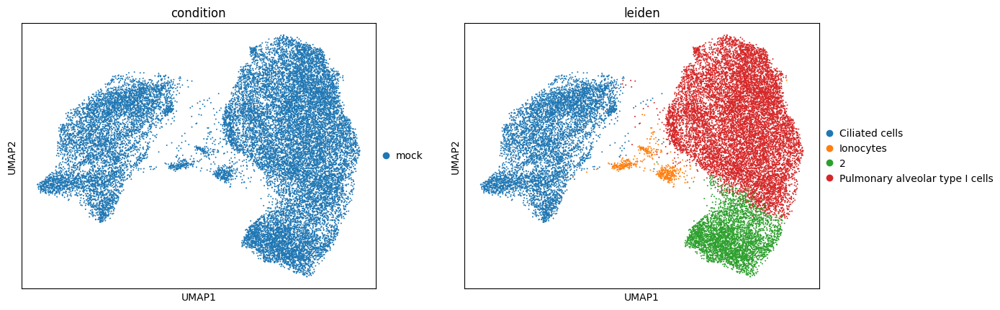

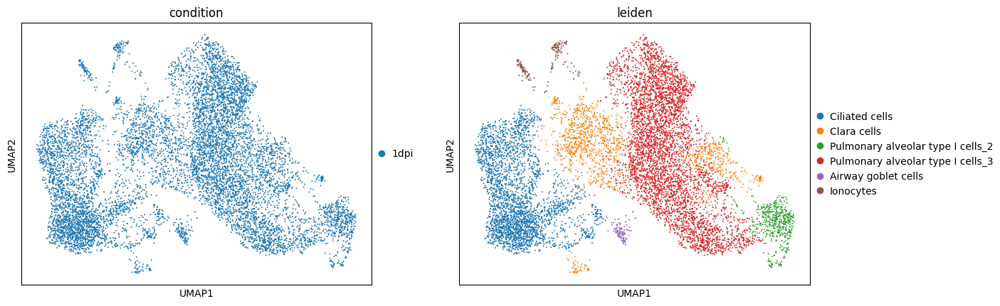

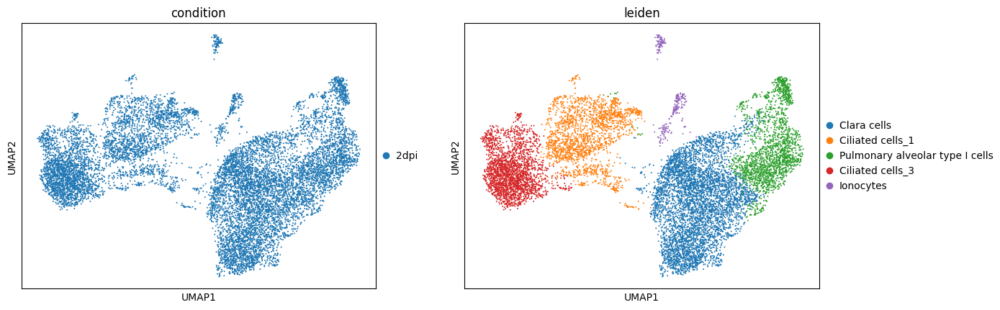

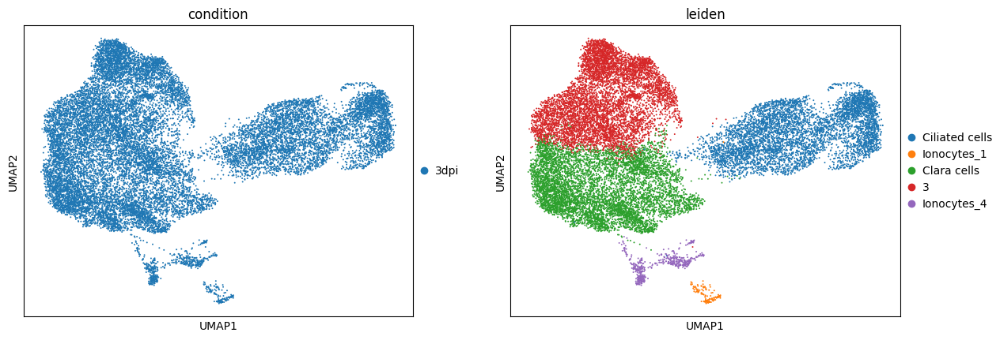

In [98]:
# visualize clustering of each group with cell type annotations
sc.pl.umap(mock_adata, color=['condition','leiden'], size=8)
sc.pl.umap(dpi1_adata, color=['condition','leiden'], size=8)
sc.pl.umap(dpi2_adata, color=['condition','leiden'], size=8)
sc.pl.umap(dpi3_adata, color=['condition','leiden'], size=8)

In [120]:
# Visualization of marker gene levels
available_genes = set(mock_adata.var_names)

# Subset marker genes for basal cells, ciliated cells, neuroendocrine cells, ionocytes, tuft cells, and goblet cells
epit_markers = markers[markers['source'].isin(['Airway epithelial cells'])]['target']
epit_markers = epit_markers[epit_markers.isin(available_genes)]

goblet_markers = markers[markers['source'].isin(['Airway goblet cells'])]['target']
goblet_markers = goblet_markers[goblet_markers.isin(available_genes)]

ciliated_markers = markers[markers['source'].isin(['Ciliated cells'])]['target']
ciliated_markers = ciliated_markers[ciliated_markers.isin(available_genes)]

club_markers = markers[markers['source'].isin(['Clara cells'])]['target']
club_markers = club_markers[club_markers.isin(available_genes)]

ionocyte_markers = markers[markers['source'].isin(['Ionocytes'])]['target']
ionocyte_markers = ionocyte_markers[ionocyte_markers.isin(available_genes)]

type1_markers = markers[markers['source'].isin(['Pulmonary alveolar type I cells'])]['target']
type1_markers = type1_markers[type1_markers.isin(available_genes)]

# create dictionary of marker genes
marker_genes = {
    'Epithelial': epit_markers.head().tolist(),
    'Ciliated': ciliated_markers.head().tolist(),
    'Club (Clara)': club_markers.head().tolist(),
    'Ionocyte': ionocyte_markers.head().tolist(),
    'Alveolar': type1_markers.head().tolist(),
    'Goblet': goblet_markers.head().tolist()
}

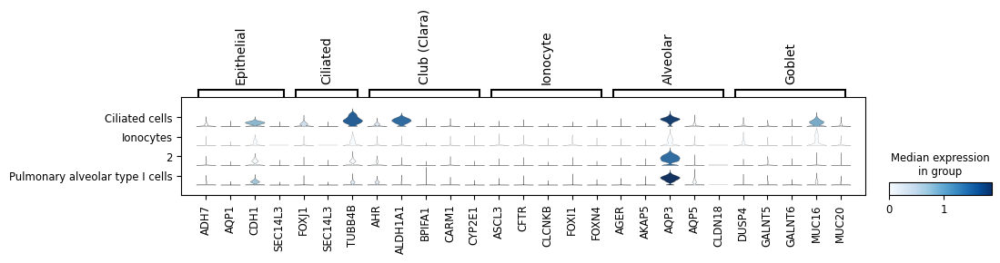

In [121]:
# visualize marker gene levels in a stacked violin plot
sc.pl.stacked_violin(mock_adata, marker_genes, groupby='leiden')

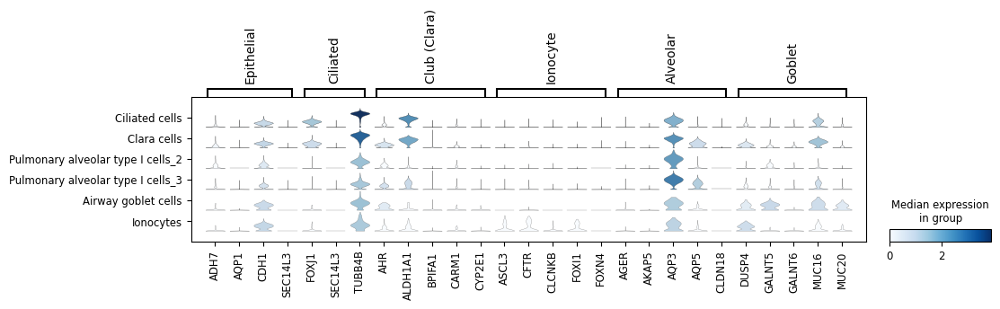

In [127]:
available_genes = set(dpi1_adata.var_names)

sc.pl.stacked_violin(dpi1_adata, marker_genes, groupby='leiden')

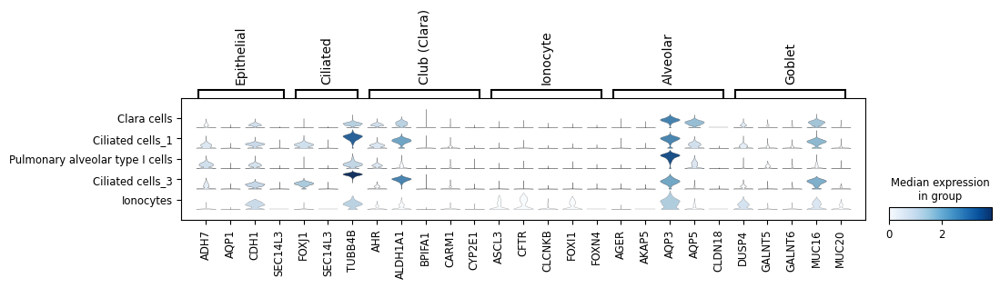

In [128]:
available_genes = set(dpi2_adata.var_names)

sc.pl.stacked_violin(dpi2_adata, marker_genes, groupby='leiden')

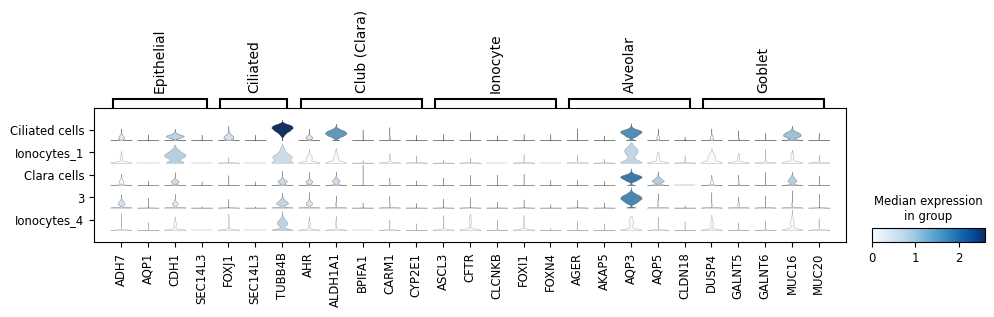

In [129]:
available_genes = set(dpi3_adata.var_names)

sc.pl.stacked_violin(dpi3_adata, marker_genes, groupby='leiden')

### Expression levels for ACE2 receptor, CTSL, TMPRSS2, and TMPRSS4 proteases (Fig.4A)

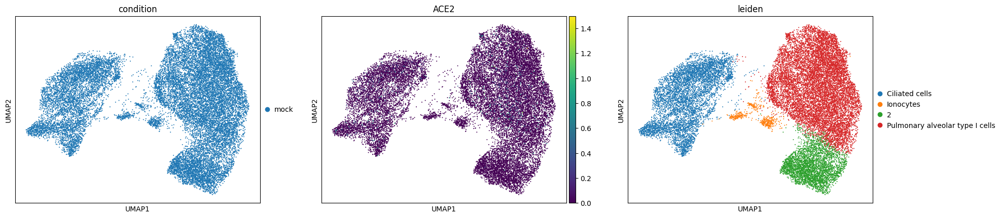

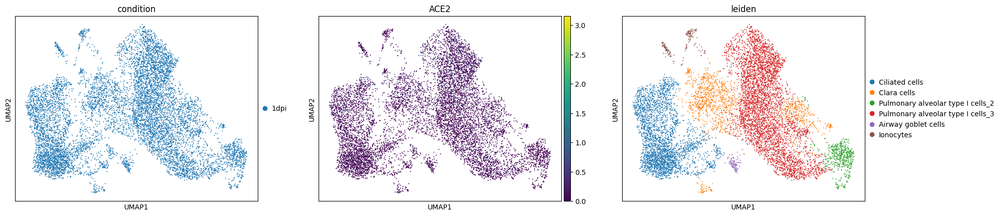

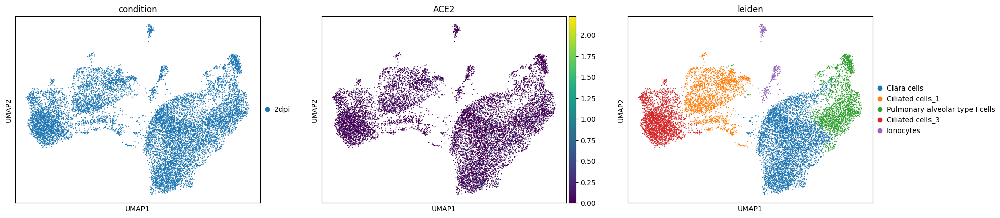

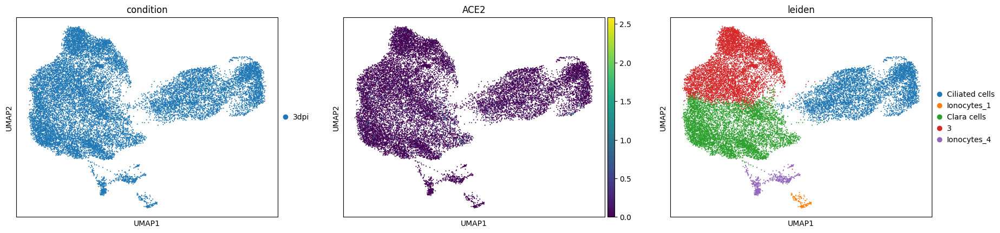

In [105]:
# ACE2 levels
sc.pl.umap(mock_adata, color=['condition','ACE2','leiden'], size=8)
sc.pl.umap(dpi1_adata, color=['condition','ACE2','leiden'], size=8)
sc.pl.umap(dpi2_adata, color=['condition','ACE2','leiden'], size=8)
sc.pl.umap(dpi3_adata, color=['condition','ACE2','leiden'], size=8)

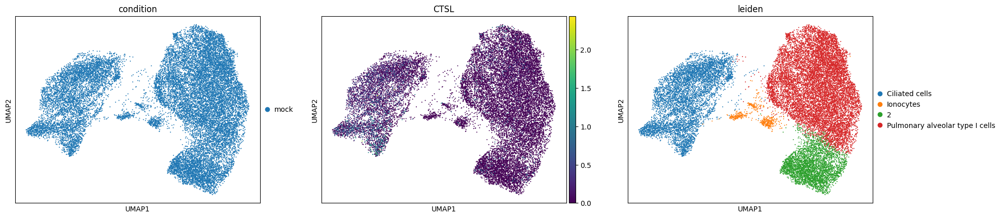

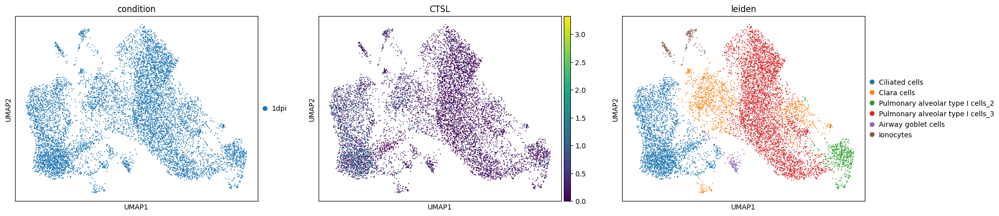

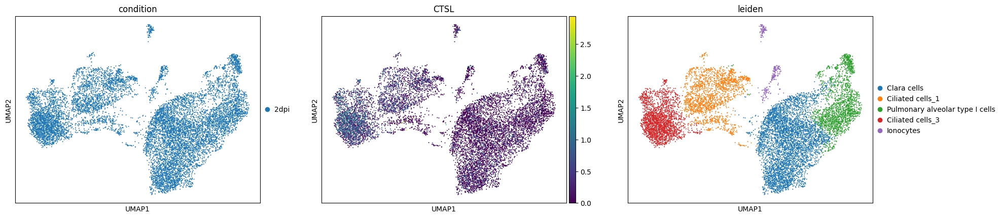

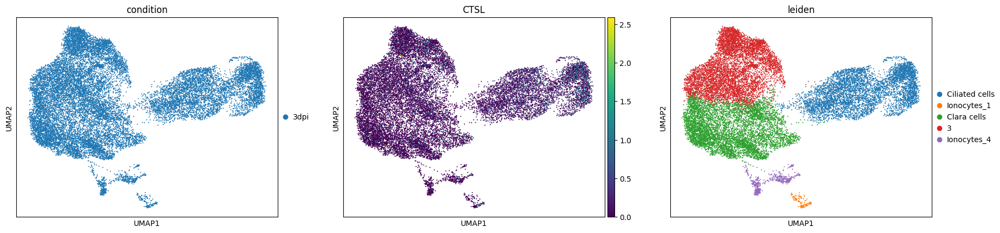

In [106]:
# CTSL levels
sc.pl.umap(mock_adata, color=['condition','CTSL','leiden'], size=8)
sc.pl.umap(dpi1_adata, color=['condition','CTSL','leiden'], size=8)
sc.pl.umap(dpi2_adata, color=['condition','CTSL','leiden'], size=8)
sc.pl.umap(dpi3_adata, color=['condition','CTSL','leiden'], size=8)

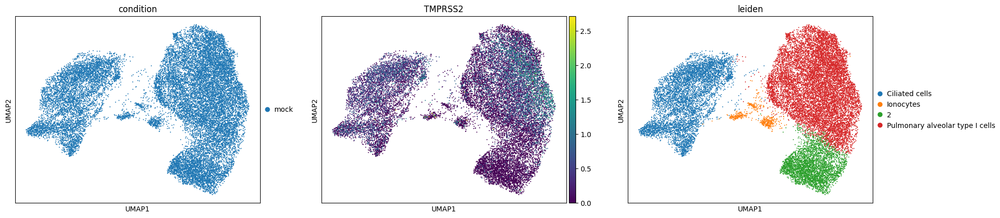

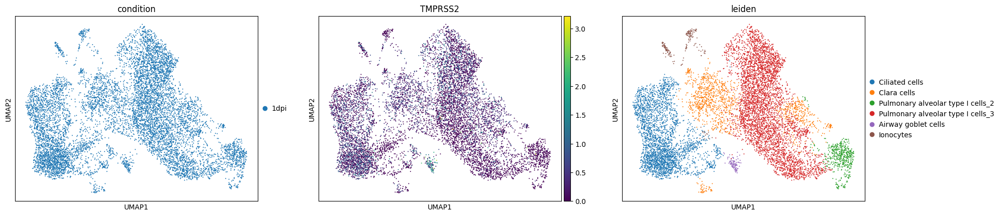

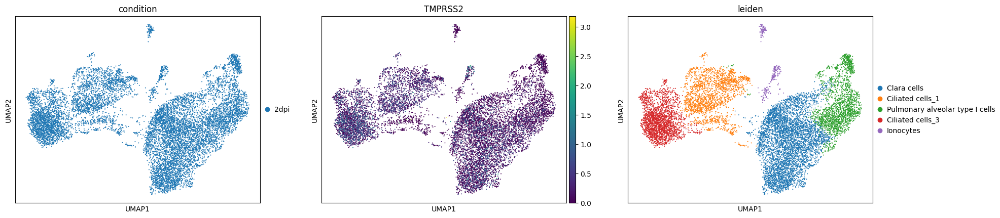

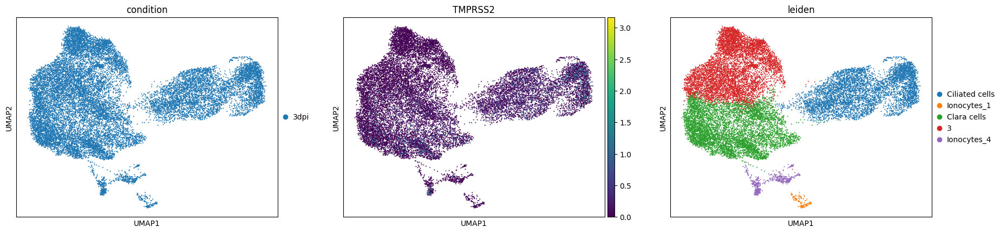

In [107]:
# TMPRSS2 levels
sc.pl.umap(mock_adata, color=['condition','TMPRSS2','leiden'], size=8)
sc.pl.umap(dpi1_adata, color=['condition','TMPRSS2','leiden'], size=8)
sc.pl.umap(dpi2_adata, color=['condition','TMPRSS2','leiden'], size=8)
sc.pl.umap(dpi3_adata, color=['condition','TMPRSS2','leiden'], size=8)

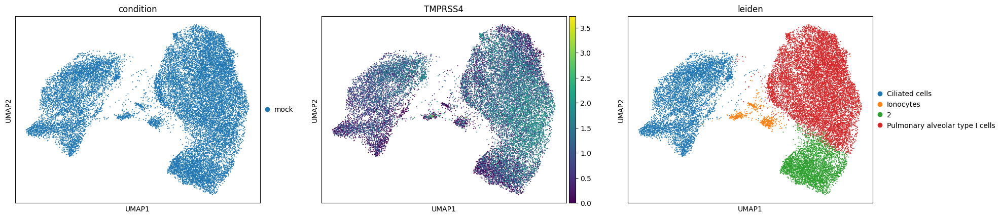

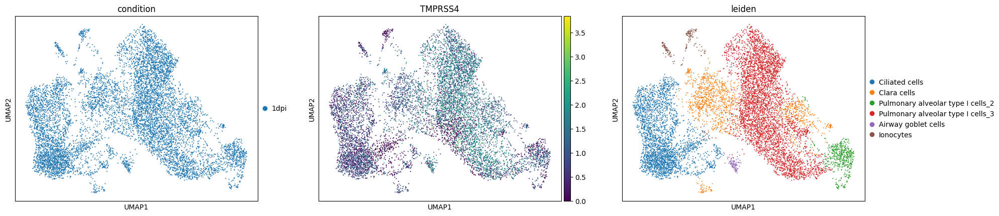

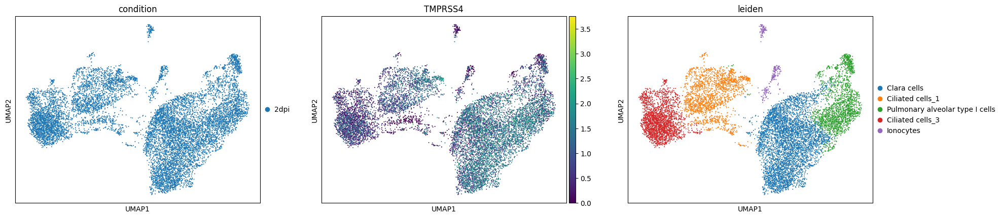

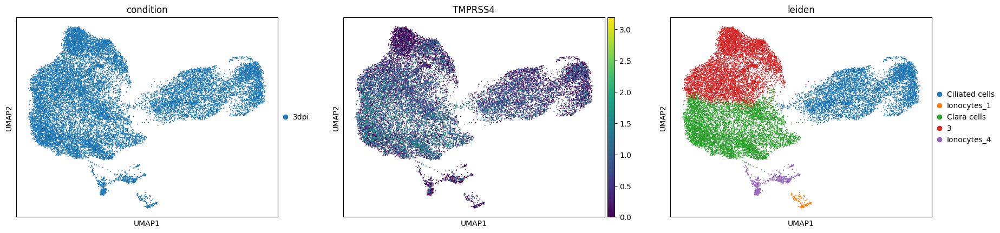

In [108]:
# TMPRSS4 levels
sc.pl.umap(mock_adata, color=['condition','TMPRSS4','leiden'], size=8)
sc.pl.umap(dpi1_adata, color=['condition','TMPRSS4','leiden'], size=8)
sc.pl.umap(dpi2_adata, color=['condition','TMPRSS4','leiden'], size=8)
sc.pl.umap(dpi3_adata, color=['condition','TMPRSS4','leiden'], size=8)

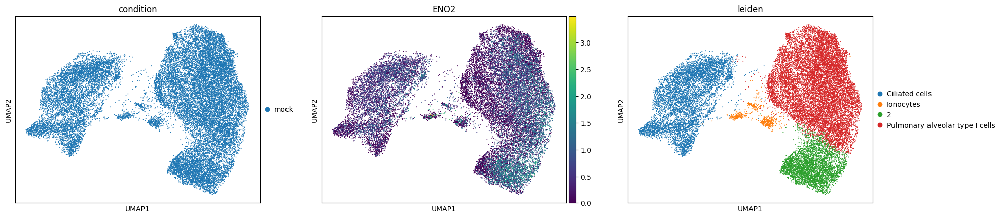

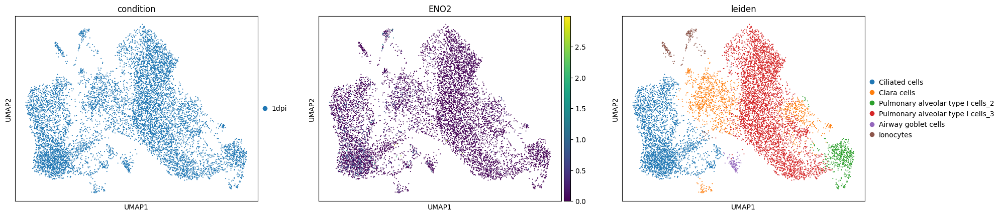

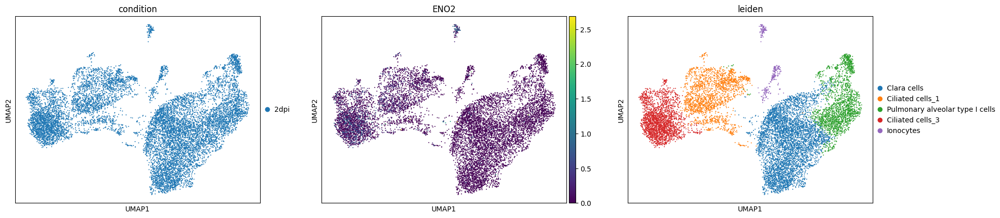

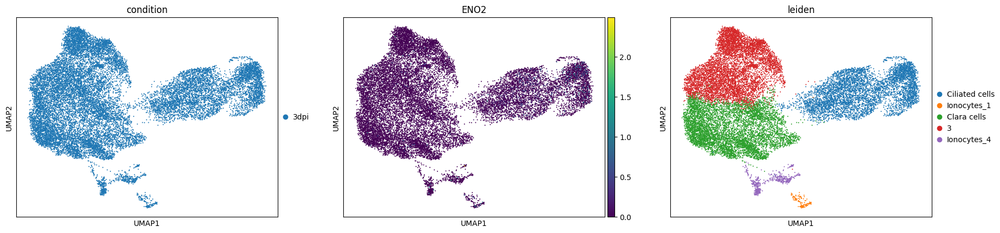

In [109]:
# ENO2 levels
sc.pl.umap(mock_adata, color=['condition','ENO2','leiden'], size=8)
sc.pl.umap(dpi1_adata, color=['condition','ENO2','leiden'], size=8)
sc.pl.umap(dpi2_adata, color=['condition','ENO2','leiden'], size=8)
sc.pl.umap(dpi3_adata, color=['condition','ENO2','leiden'], size=8)

### Visualize levels of SARS-CoV-2 target cells over days post-infection (Ciliated cells, Club (Clara) cells)

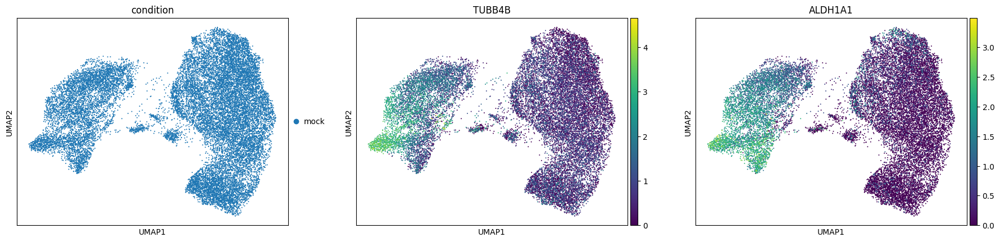

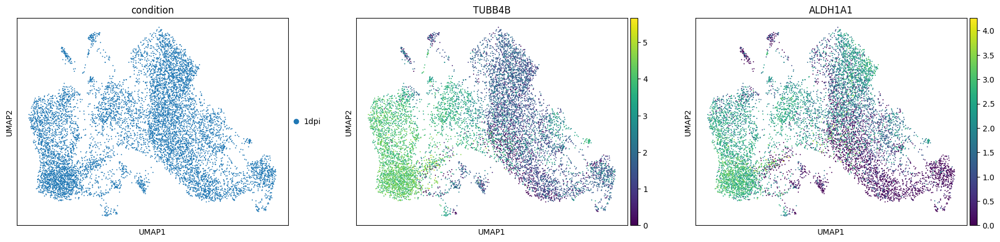

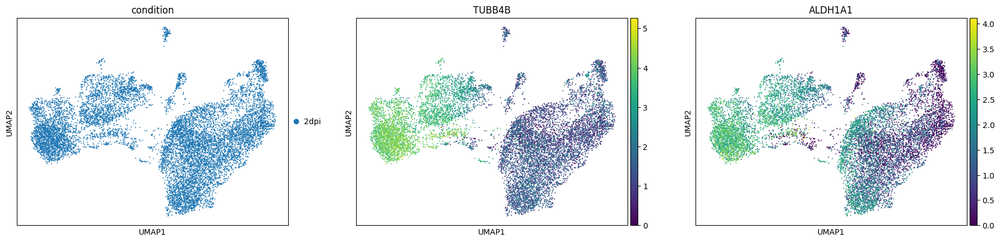

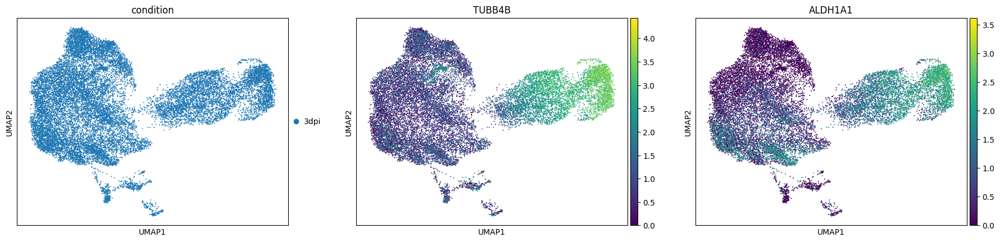

In [111]:
# Visualize levels of Ciliated and Clara cell marker genes (TUBB4B and ALDH1A1)
sc.pl.umap(mock_adata, color=['condition','TUBB4B','ALDH1A1'], size=8)
sc.pl.umap(dpi1_adata, color=['condition','TUBB4B','ALDH1A1'], size=8)
sc.pl.umap(dpi2_adata, color=['condition','TUBB4B','ALDH1A1'], size=8)
sc.pl.umap(dpi3_adata, color=['condition','TUBB4B','ALDH1A1'], size=8)

## 5. Trajectory Analysis
For tracking cell differentiation after 3 days of infection

In [112]:
# build a graph from 3dpi expression data
sc.tl.draw_graph(dpi3_adata)

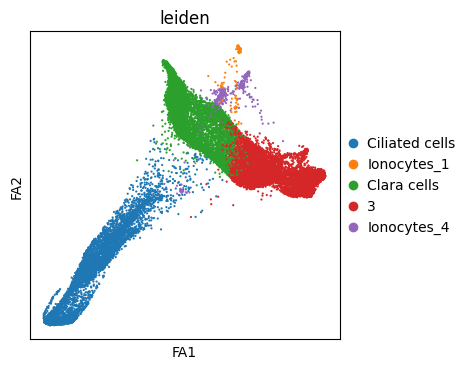

In [113]:
# display the graph
import matplotlib.pyplot as plt

plt.rcParams['figure.figsize'] = (4,4)
sc.pl.draw_graph(dpi3_adata, color='leiden', size = 10)

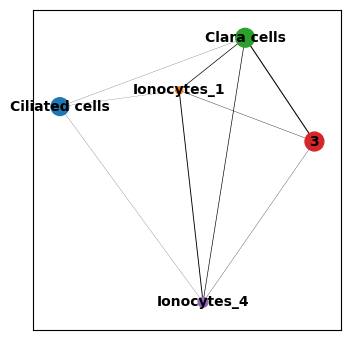

In [114]:
# graph abstraction
sc.tl.paga(dpi3_adata, groups='leiden')

# visualize the abstracted graph
sc.pl.paga(dpi3_adata, color=['leiden'])

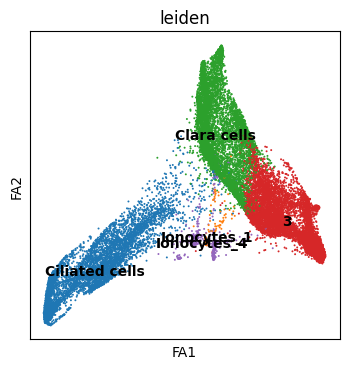

In [115]:
# rebuild and display graph after abstraction
sc.tl.draw_graph(dpi3_adata, init_pos='paga')
sc.pl.draw_graph(dpi3_adata, color='leiden', legend_loc='on data', size=8)

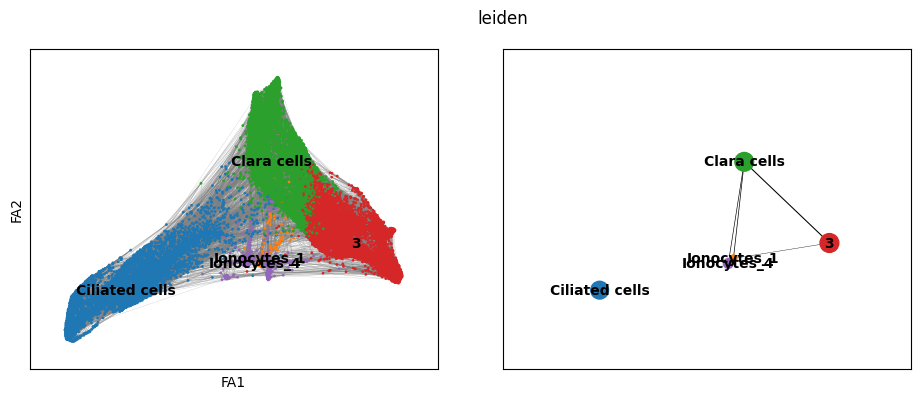

[<Axes: xlabel='FA1', ylabel='FA2'>, <Axes: >]

In [116]:
# compare figures with and without abstraction
plt.rcParams['figure.figsize'] = (5,4)
sc.pl.paga_compare(dpi3_adata, threshold=0.03, frameon=True, edges=True, size=16)

In [117]:
# pseudotime analysis
dpi3_adata.uns['iroot'] = np.flatnonzero(dpi3_adata.obs['leiden'] == 'Clara cells')[0]

In [118]:
sc.tl.dpt(dpi3_adata)

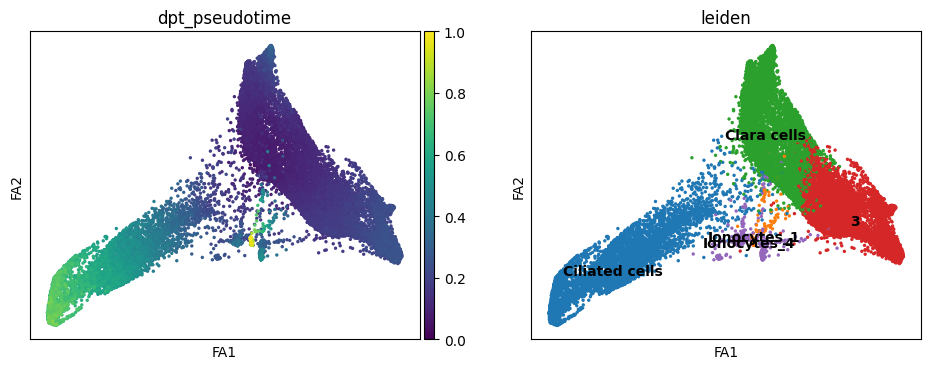

In [119]:
# draw graph with pseudotime
sc.pl.draw_graph(dpi3_adata, color=['dpt_pseudotime', 'leiden'],
                 legend_loc='on data', size=24)